In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.neural_network import MLPRegressor
pd.set_option('display.max_columns', None) 

In [2]:
listings = pd.read_csv('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/data/raw/listings 2.csv')
display(listings.head())

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,39971294,https://www.airbnb.com/rooms/39971294,20220613034419,2022-06-13,Cozy flat with chimney,NaN,NaN,https://a0.muscache.com/pictures/a10c1d51-2954...,21565256,https://www.airbnb.com/users/show/21565256,Tanja,2014-09-20,"Berlin, Berlin, Germany",Hey there! I´m a Bavarian girl living in the b...,NaN,NaN,NaN,f,https://a0.muscache.com/im/pictures/user/33341...,https://a0.muscache.com/im/pictures/user/33341...,NaN,1.0,1.0,"['email', 'phone', 'work_email']",t,t,NaN,nördliche Luisenstadt,Friedrichshain-Kreuzberg,52.501680,13.415730,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,1,1125,1,1,1125,1125,1.0,1125.0,NaN,t,0,0,0,0,2022-06-13,2,0,0,2019-11-16,2019-12-02,5.00,5.00,5.00,5.00,5.00,5.00,5.00,NaN,f,1,1,0,0,0.06
1,11934470,https://www.airbnb.com/rooms/11934470,20220613034419,2022-06-13,Bright Studio Apartment / 4th fl/ long term,Just renovedt Studio apartment a few steps fro...,NaN,https://a0.muscache.com/pictures/56a1ce3f-e2c6...,62819516,https://www.airbnb.com/users/show/62819516,Carla & Daniel,2016-03-13,"Berlin, Berlin, Germany",NaN,within an hour,100%,100%,t,https://a0.muscache.com/im/pictures/user/7db64...,https://a0.muscache.com/im/pictures/user/7db64...,Neukölln,2.0,2.0,"['email', 'phone']",t,t,NaN,Reuterstraße,Neukölln,52.492260,13.429370,Entire rental unit,Entire home/apt,1,NaN,1 bath,NaN,1.0,"[""Long term stays allowed"", ""Washer"", ""Hair dr...",$43.00,30,730,5,60,7,1125,38.4,823.8,NaN,t,0,7,8,271,2022-06-13,5,3,0,2016-04-27,2022-03-29,4.60,5.00,4.80,4.40,4.80,4.60,4.20,NaN,t,2,2,0,0,0.07
2,17580693,https://www.airbnb.com/rooms/17580693,20220613034419,2022-06-13,"Gemütliches, Zentrales Zimmer mit Blick ins Grüne","Meine Unterkunft ist gut für paare, alleinreis...",NaN,https://a0.muscache.com/pictures/91db5cb4-ab79...,119416956,https://www.airbnb.com/users/show/119416956,Sven,2017-03-06,"Berlin, Berlin, Germany",NaN,within a few hours,100%,62%,f,https://a0.muscache.com/im/pictures/user/6372a...,https://a0.muscache.com/im/pictures/user/6372a...,Wedding,1.0,1.0,"['email', 'phone']",t,t,NaN,Parkviertel,Mitte,52.561510,13.355150,Private room in condo,Private room,1,NaN,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,2,10,2,2,10,10,2.0,10.0,NaN,t,0,0,10,10,2022-06-13,31,4,0,2017-05-28,2022-03-07,4.65,4.77,4.58,4.81,4.84,4.71,4.68,NaN,f,1,0,1,0,0.50
3,579471587567149993,https://www.airbnb.com/rooms/579471587567149993,20220613034419,2022-06-13,Süßes Altbau-Apartment in Schöneberg,"Praktikum, berufliches Projekt oder Besuch bei...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,9916942,https://www.airbnb.com/u

In [3]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16416 entries, 0 to 16415
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            16416 non-null  int64  
 1   listing_url                                   16416 non-null  object 
 2   scrape_id                                     16416 non-null  int64  
 3   last_scraped                                  16416 non-null  object 
 4   name                                          16392 non-null  object 
 5   description                                   16067 non-null  object 
 6   neighborhood_overview                         8706 non-null   object 
 7   picture_url                                   16416 non-null  object 
 8   host_id                                       16416 non-null  int64  
 9   host_url                                      16416 non-null 

In [4]:
### Voy a quitar unas columnas de antemano que pienso que no seran relevantes para el modelo

listings = listings.drop(["listing_url", "scrape_id", "host_url", "host_location",
                         "host_thumbnail_url", "host_neighbourhood", "host_listings_count",
                         "neighborhood_overview", "host_verifications", "minimum_minimum_nights",
                         "maximum_minimum_nights", "minimum_maximum_nights", "maximum_maximum_nights",
                         "minimum_nights_avg_ntm", "maximum_nights_avg_ntm", 
                         "description", "host_about", "has_availability", "availability_30", 
                         "availability_60", "availability_90", "availability_365",
                         "picture_url", "host_picture_url", "last_scraped",
                         "name", "host_id", "host_name", "host_since",
                         "host_has_profile_pic", "calendar_last_scraped",
                         "number_of_reviews_ltm", "number_of_reviews_l30d",
                         "first_review", "last_review", "calculated_host_listings_count_entire_homes",
                         "calculated_host_listings_count_private_rooms", "calculated_host_listings_count_shared_rooms",
                         "host_total_listings_count", "host_identity_verified",
                         "maximum_nights", "minimum_nights"], axis = 1)
listings.head()

,id,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,calendar_updated,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,reviews_per_month
0,39971294,NaN,NaN,NaN,f,NaN,nördliche Luisenstadt,Friedrichshain-Kreuzberg,52.501680,13.415730,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,NaN,2,5.00,5.00,5.00,5.00,5.00,5.00,5.00,NaN,f,1,0.06
1,11934470,within an hour,100%,100%,t,NaN,Reuterstraße,Neukölln,52.492260,13.429370,Entire rental unit,Entire home/apt,1,NaN,1 bath,NaN,1.0,"[""Long term stays allowed"", ""Washer"", ""Hair dr...",$43.00,NaN,5,4.60,5.00,4.80,4.40,4.80,4.60,4.20,NaN,t,2,0.07
2,17580693,within a few hours,100%,62%,f,NaN,Parkviertel,Mitte,52.561510,13.355150,Private room in condo,Private room,1,NaN,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,NaN,31,4.65,4.77,4.58,4.81,4.84,4.71,4.68,NaN,f,1,0.50
3,579471587567149993,NaN,NaN,NaN,f,NaN,Friedenau,Tempelhof - Schöneberg,52.477266,13.336424,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,2.0,"[""Long term stays allowed"", ""Washer"", ""Kitchen...",$52.00,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,1,NaN
4,17497917,within a few hours,100%,92%,t,"Berlin, Germany",Alexanderplatz,Mitte,52.524380,13.410120,Entire rental unit,Entire home/apt,2,NaN,1 bath,1.0,1.0,"[""Essentials"", ""Long term stays allowed"", ""Pai...",$106.00,NaN,116,4.90,4.94,4.95,4.84,4.87,4.96,4.70,NaN,f,1,1.84


In [5]:
### Aqui analizare que columnas tienen una cantidad substancial de missing values y en caso
### de que no sean muy relevantes las quitare del dataframe. Si me interesan vere como reemplazo
### o remuevo los missing values 

listings.isna().sum()

id                                    0
host_response_time                 8393
host_response_rate                 8393
host_acceptance_rate               7405
host_is_superhost                    10
neighbourhood                      7709
neighbourhood_cleansed                0
neighbourhood_group_cleansed          0
latitude                              0
longitude                             0
property_type                         0
room_type                             0
accommodates                          0
bathrooms                         16416
bathrooms_text                       18
bedrooms                           1370
beds                                339
amenities                             0
price                                 0
calendar_updated                  16416
number_of_reviews                     0
review_scores_rating               2883
review_scores_accuracy             3150
review_scores_cleanliness          3148
review_scores_checkin              3162


In [6]:
### Las siguienntes columnas las voy a quitar porque tienen muchos missing values y la informacion
### no creo que aporte mucho al modelo. En el caso de bathrooms la informacion parece estar 
### en "bathrooms_text" y en el caso de "neighbourhood" en "neighbourhood_cleansed" 

listings = listings.drop(["host_response_time", "host_response_rate", "neighbourhood",
                         "bathrooms", "calendar_updated", "license", "host_acceptance_rate"], axis = 1)
listings.head()

,id,host_is_superhost,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,reviews_per_month
0,39971294,f,nördliche Luisenstadt,Friedrichshain-Kreuzberg,52.501680,13.415730,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,2,5.00,5.00,5.00,5.00,5.00,5.00,5.00,f,1,0.06
1,11934470,t,Reuterstraße,Neukölln,52.492260,13.429370,Entire rental unit,Entire home/apt,1,1 bath,NaN,1.0,"[""Long term stays allowed"", ""Washer"", ""Hair dr...",$43.00,5,4.60,5.00,4.80,4.40,4.80,4.60,4.20,t,2,0.07
2,17580693,f,Parkviertel,Mitte,52.561510,13.355150,Private room in condo,Private room,1,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,31,4.65,4.77,4.58,4.81,4.84,4.71,4.68,f,1,0.50
3,579471587567149993,f,Friedenau,Tempelhof - Schöneberg,52.477266,13.336424,Entire rental unit,Entire home/apt,2,1 bath,1.0,2.0,"[""Long term stays allowed"", ""Washer"", ""Kitchen...",$52.00,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t,1,NaN
4,17497917,t,Alexanderplatz,Mitte,52.524380,13.410120,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Essentials"", ""Long term stays allowed"", ""Pai...",$106.00,116,4.90,4.94,4.95,4.84,4.87,4.96,4.70,f,1,1.84


In [7]:
listings.isna().sum()

id                                   0
host_is_superhost                   10
neighbourhood_cleansed               0
neighbourhood_group_cleansed         0
latitude                             0
longitude                            0
property_type                        0
room_type                            0
accommodates                         0
bathrooms_text                      18
bedrooms                          1370
beds                               339
amenities                            0
price                                0
number_of_reviews                    0
review_scores_rating              2883
review_scores_accuracy            3150
review_scores_cleanliness         3148
review_scores_checkin             3162
review_scores_communication       3151
review_scores_location            3161
review_scores_value               3163
instant_bookable                     0
calculated_host_listings_count       0
reviews_per_month                 2883
dtype: int64

In [8]:
### I will drop the Nas of these columns, since the number is not so big

listings = listings.dropna(subset=["host_is_superhost", "bathrooms_text", "bedrooms", "beds",
                                  "review_scores_rating", "review_scores_accuracy", 
                                   "review_scores_cleanliness", "review_scores_checkin", "review_scores_communication", 
                                   "review_scores_location", "review_scores_value", "reviews_per_month"])
print(listings.isna().sum())
print(listings.shape)

id                                0
host_is_superhost                 0
neighbourhood_cleansed            0
neighbourhood_group_cleansed      0
latitude                          0
longitude                         0
property_type                     0
room_type                         0
accommodates                      0
bathrooms_text                    0
bedrooms                          0
beds                              0
amenities                         0
price                             0
number_of_reviews                 0
review_scores_rating              0
review_scores_accuracy            0
review_scores_cleanliness         0
review_scores_checkin             0
review_scores_communication       0
review_scores_location            0
review_scores_value               0
instant_bookable                  0
calculated_host_listings_count    0
reviews_per_month                 0
dtype: int64
(11978, 25)


In [9]:
### Now I will replace the rows of the review columns that do not have a review with 0

#cols = ["review_scores_rating", "review_scores_accuracy", "review_scores_cleanliness",
      #"review_scores_checkin", "review_scores_communication", "review_scores_location",
      #"review_scores_value", "reviews_per_month"]

#for col in cols:
    #listings[col] = listings[col].fillna(0)

In [10]:
#print(listings.isna().sum())
#print(listings["review_scores_rating"].value_counts())

In [11]:
### Now I will take a look a the column types

listings.info()

### Clearly, it seems "price" needs to be fixed, also, the number of bathrooms should be an interger

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11978 entries, 0 to 16411
Data columns (total 25 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              11978 non-null  int64  
 1   host_is_superhost               11978 non-null  object 
 2   neighbourhood_cleansed          11978 non-null  object 
 3   neighbourhood_group_cleansed    11978 non-null  object 
 4   latitude                        11978 non-null  float64
 5   longitude                       11978 non-null  float64
 6   property_type                   11978 non-null  object 
 7   room_type                       11978 non-null  object 
 8   accommodates                    11978 non-null  int64  
 9   bathrooms_text                  11978 non-null  object 
 10  bedrooms                        11978 non-null  float64
 11  beds                            11978 non-null  float64
 12  amenities                       

In [12]:
### Now I will take a closer look at the columns to fix them 

listings["bathrooms_text"].value_counts(dropna = False)

1 bath               6576
1 shared bath        2867
1 private bath        696
2 baths               590
1.5 baths             587
1.5 shared baths      289
2 shared baths        158
2.5 baths              89
3 baths                24
0 shared baths         20
Half-bath              18
2.5 shared baths       16
4 baths                10
Shared half-bath        9
3.5 baths               6
Private half-bath       5
0 baths                 5
4.5 shared baths        3
4.5 baths               3
7 baths                 2
6 baths                 1
8 baths                 1
3 shared baths          1
5 baths                 1
4 shared baths          1
Name: bathrooms_text, dtype: int64

In [13]:
### I will first clean the column "bathrooms_text"

def clean_bath(row):
    if "shared" in row["bathrooms_text"]:
        return "True"
    else:
        return "False"

In [14]:
listings["shared_bathroom"] = listings.apply(clean_bath, axis = 1)
listings

,id,host_is_superhost,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,reviews_per_month,shared_bathroom
0,39971294,f,nördliche Luisenstadt,Friedrichshain-Kreuzberg,52.50168,13.41573,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Indoor fireplace"", ""Essentials"", ""Hot water""...",$50.00,2,5.00,5.00,5.00,5.00,5.00,5.00,5.00,f,1,0.06,False
2,17580693,f,Parkviertel,Mitte,52.56151,13.35515,Private room in condo,Private room,1,1 shared bath,1.0,1.0,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating""...",$42.00,31,4.65,4.77,4.58,4.81,4.84,4.71,4.68,f,1,0.50,True
4,17497917,t,Alexanderplatz,Mitte,52.52438,13.41012,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Essentials"", ""Long term stays allowed"", ""Pai...",$106.00,116,4.90,4.94,4.95,4.84,4.87,4.96,4.70,f,1,1.84,False
5,9924899,f,Tempelhofer Vorstadt,Friedrichshain-Kreuzberg,52.49087,13.41712,Private room in rental unit,Private room,1,1 shared bath,1.0,1.0,"[""Essentials"", ""Hot water"", ""Hair dryer"", ""Kit...",$39.00,7,5.00,5.00,4.86,5.00,5.00,5.00,5.00,f,2,0.09,True
6,37167219,f,südliche Luisenstadt,Friedrichshain-Kreuzberg,52.49781,13.43814,Private room in rental unit,Private room,4,1 private bath,2.0,2.0,"[""Essentials"", ""Hot water"", ""Long term stays a...",$80.00,4,4.50,4.50,3.50,4.75,5.00,4.50,4.50,f,1,0.36,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16405,45853833,f,Moabit Ost,Mitte,52.52822,13.37229,Entire rental unit,Entire home/apt,2,1 bath,1.0,1.0,"[""Long term stays allowed"", ""Washer"", ""Kitchen...",$200.00,2,5.00,5.00,5.00,5.00,5.00,5.00,5.00,t,1,0.77,False
16406,36310423,f,Prenzlauer Berg Ost,Pankow,52.54662,13.44661,Entire rental unit,Entire home/apt,4,1 bath,2.0,2.0,"[""Essentials"", ""Host greets you"", ""Hair dryer""...",$110.00,88,4.75,4.75,4.49,4.89,4.99,4.75,4.70,t,1,2.49,False
16409,52281412,f,Hellersdorf-Nord,Marzahn - Hellersdorf,52.53745,13.60328,Private room in rental unit,Private room,1,2 baths,1.0,1.0,"[""Long term stays allowed"", ""Washer"", ""Kitchen...",$20.00,1,5.00,5.00,3.00,5.00,5.00,4.00,5.00,t,2,0.12,False
16410,2648992,f,Friedrichsfelde Nord,Lichtenberg,52.51377,13.52511,Private room in tiny home,Private room,2,1 shared bath,1.0,2.0,"[""Fire extinguisher"", ""Essentials"", ""Free park...",$89.00,9,4.33,4.56,4.67,4.78,4.89,4.22,4.33,f,3,0.12,True


In [15]:
def clean_bath2(x):
    if re.match('\d{1}.\d{1}', x):
        y = re.findall('\d{1}.\d{1}', x)
        return y[0]
    if re.match('\d{1}', x):
        y = re.findall('\d{1}', x)
        return y[0]
    else:
        return "0.5"

In [16]:
listings["bathrooms_text"] = list(map(clean_bath2, listings["bathrooms_text"]))
listings["bathrooms_text"] = pd.to_numeric(listings["bathrooms_text"])
listings["bathrooms_text"].value_counts()

1.0    10139
1.5      876
2.0      748
2.5      105
0.5       32
3.0       25
0.0       25
4.0       11
4.5        6
3.5        6
7.0        2
6.0        1
8.0        1
5.0        1
Name: bathrooms_text, dtype: int64

In [17]:
### Now I will clean the column "price"

listings["price"].value_counts()

$50.00     459
$30.00     425
$40.00     416
$35.00     382
$60.00     377
          ... 
$469.00      1
$380.00      1
$314.00      1
$306.00      1
$412.00      1
Name: price, Length: 445, dtype: int64

In [18]:
def clean_price(x):
    y = ""
    for char in x:
        if char == "$":
            pass
        elif char == ",":
            pass
        else:
            y = y + char
    return y

In [19]:
listings["price"] = list(map(clean_price, listings["price"]))
listings["price"] = pd.to_numeric(listings["price"])
listings["price"].value_counts()

50.0     459
30.0     425
40.0     416
35.0     382
60.0     377
        ... 
469.0      1
380.0      1
314.0      1
306.0      1
412.0      1
Name: price, Length: 445, dtype: int64

In [20]:
listings = listings.rename(columns={'bathrooms_text': 'n_bathrooms'})
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11978 entries, 0 to 16411
Data columns (total 26 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              11978 non-null  int64  
 1   host_is_superhost               11978 non-null  object 
 2   neighbourhood_cleansed          11978 non-null  object 
 3   neighbourhood_group_cleansed    11978 non-null  object 
 4   latitude                        11978 non-null  float64
 5   longitude                       11978 non-null  float64
 6   property_type                   11978 non-null  object 
 7   room_type                       11978 non-null  object 
 8   accommodates                    11978 non-null  int64  
 9   n_bathrooms                     11978 non-null  float64
 10  bedrooms                        11978 non-null  float64
 11  beds                            11978 non-null  float64
 12  amenities                       

In [21]:
listings.to_csv('/Users/origenolet/Desktop/Ironhack/Week5/Mid-bootcamp-project/data/clean/listings_clean.csv', index=False)

In [265]:
### Now I want to extract some features from the column "ammenities" to see whether 
### they would add an extra value to the property

pd.set_option('max_colwidth', None)
pd.set_option('display.max_rows', None)
ammenities = listings[["amenities"]]
ammenities

,amenities
0,"[""Indoor fireplace"", ""Essentials"", ""Hot water"", ""Free parking on premises"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Wifi"", ""Smoke alarm""]"
2,"[""Essentials"", ""Hair dryer"", ""Iron"", ""Heating"", ""TV"", ""Wifi"", ""Hangers""]"
4,"[""Essentials"", ""Long term stays allowed"", ""Paid parking on premises"", ""Hair dryer"", ""Coffee maker"", ""Refrigerator"", ""Stove"", ""Private patio or balcony"", ""Cooking basics"", ""Wifi"", ""Bed linens"", ""Hot water kettle"", ""Dishes and silverware"", ""65\"" HDTV with Roku, Apple TV, Amazon Prime Video, Netflix"", ""Bose Bluetooth sound system"", ""Kitchen"", ""Iron"", ""Toaster"", ""Heating"", ""Dishwasher"", ""Hangers"", ""Oven"", ""Hot water"", ""Rice maker"", ""Washer"", ""Microwave"", ""Freezer""]"
5,"[""Essentials"", ""Hot water"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Heating"", ""Wifi"", ""Bed linens"", ""Hangers""]"
6,"[""Essentials"", ""Hot water"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Heating"", ""Wifi"", ""Smoke alarm"", ""Hangers""]"
7,"[""Long term stays allowed"", ""Washer"", ""Kitchen"", ""Elevator"", ""Wifi""]"
8,"[""Dishes and silverware"", ""Shampoo"", ""Essentials"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Microwave"", ""Refrigerator"", ""Toaster"", ""Heating"", ""Cooking basics"", ""TV"", ""Wifi"", ""Bed linens"", ""Hot water kettle"", ""Hangers""]"
9,"[""Essentials"", ""Long term stays allowed"", ""Washer"", ""Hair dryer"", ""Kitchen"", ""Heating"", ""TV"", ""Wifi"", ""Hangers""]"
12,"[""Essentials"", ""Hot water"", ""Dryer"", ""Long term stays allowed"", ""Washer"", ""Kitchen"", ""Iron"", ""First aid kit"", ""Private entrance"", ""Heating"", ""TV"", ""Wifi""]"
13,"[""Essentials"", ""Long term stays allowed"", ""Hair dryer"", ""Kitchen"", ""Iron"", ""Coffee maker"", ""Refrigerator"", ""Heating"", ""Private patio or balcony"", ""Wifi"", ""Smoke alarm"", ""Free street parking""]"


In [266]:
pd.reset_option('max_colwidth', 10)
pd.reset_option('display.max_rows', 10)

In [267]:
def clean_ammenities_wifi(row):
    if "Wifi" in row["amenities"]:
        return 1
    else:
        return 0

In [268]:
def clean_ammenities_kitchen(row):
    if "Kitchen" in row["amenities"]:
        return 1
    else:
        return 0

In [269]:
def clean_ammenities_parking(row):
    if "parking" in row["amenities"]:
        return 1
    else:
        return 0

In [270]:
def clean_ammenities_balcony(row):
    if "balcony" in row["amenities"]:
        return 1
    else:
        return 0

In [271]:
def clean_ammenities_bbq(row):
    if "BBQ grill" in row["amenities"]:
        return 1
    else:
        return 0

In [272]:
def clean_ammenities_washer(row):
    if "Washer" in row["amenities"]:
        return 1
    else:
        return 0

In [273]:
ammenities["wifi"] = ammenities.apply(clean_ammenities_wifi, axis = 1)
ammenities["kitchen"] = ammenities.apply(clean_ammenities_kitchen, axis = 1)
ammenities["parking"] = ammenities.apply(clean_ammenities_parking, axis = 1)
ammenities["balcony"] = ammenities.apply(clean_ammenities_balcony, axis = 1)
ammenities["bbq"] = ammenities.apply(clean_ammenities_bbq, axis = 1)
ammenities["washer"] = ammenities.apply(clean_ammenities_washer, axis = 1)
ammenities = ammenities.drop(["amenities"], axis = 1)

/var/folders/fw/gn4y0r6102q38_7vzn4l62mw0000gp/T/ipykernel_88274/3327105013.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ammenities["wifi"] = ammenities.apply(clean_ammenities_wifi, axis = 1)
/var/folders/fw/gn4y0r6102q38_7vzn4l62mw0000gp/T/ipykernel_88274/3327105013.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ammenities["kitchen"] = ammenities.apply(clean_ammenities_kitchen, axis = 1)
/var/folders/fw/gn4y0r6102q38_7vzn4l62mw0000gp/T/ipykernel_88274/3327105013.py:3: SettingWithCopyWarning: 
A

In [274]:
ammenities.head()

,wifi,kitchen,parking,balcony,bbq,washer
0,1,1,1,0,0,1
2,1,0,0,0,0,0
4,1,1,1,1,0,1
5,1,1,0,0,0,0
6,1,1,0,0,0,1


In [275]:
cat = listings.select_dtypes("object").drop(["amenities"], axis = 1)
cat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11978 entries, 0 to 16411
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   host_is_superhost             11978 non-null  object
 1   neighbourhood_cleansed        11978 non-null  object
 2   neighbourhood_group_cleansed  11978 non-null  object
 3   property_type                 11978 non-null  object
 4   room_type                     11978 non-null  object
 5   instant_bookable              11978 non-null  object
 6   shared_bathroom               11978 non-null  object
dtypes: object(7)
memory usage: 748.6+ KB


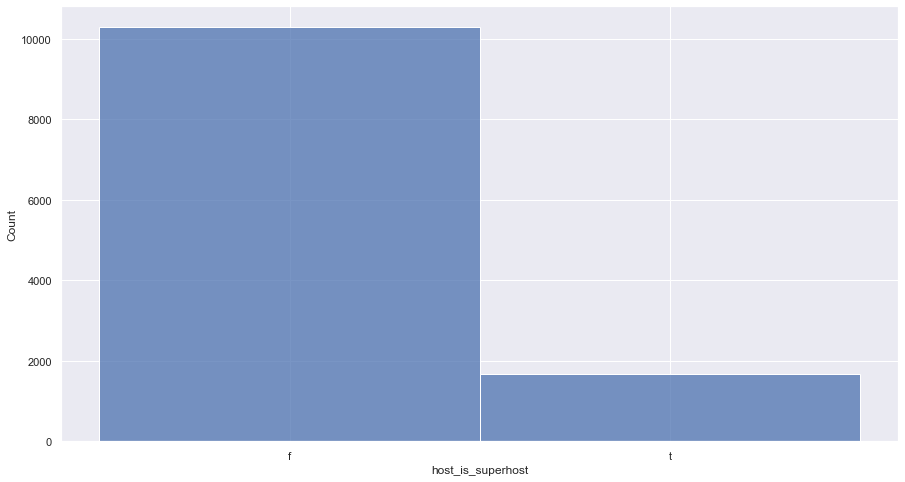

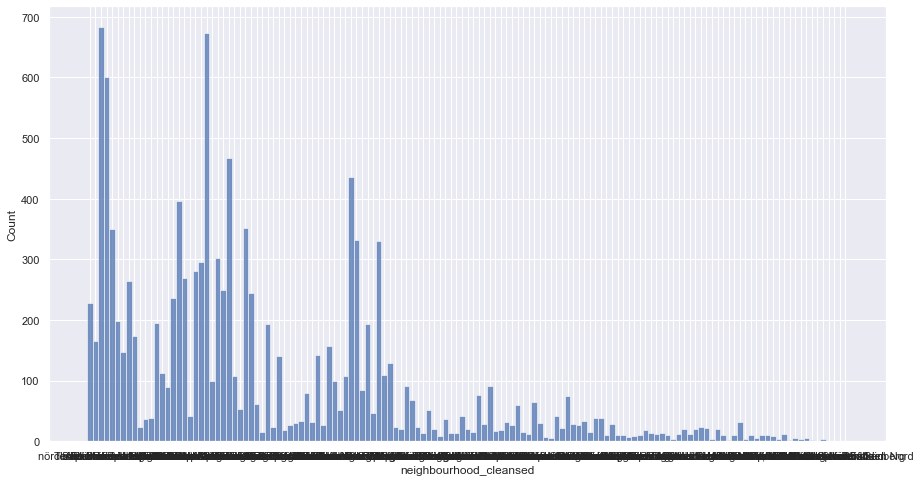

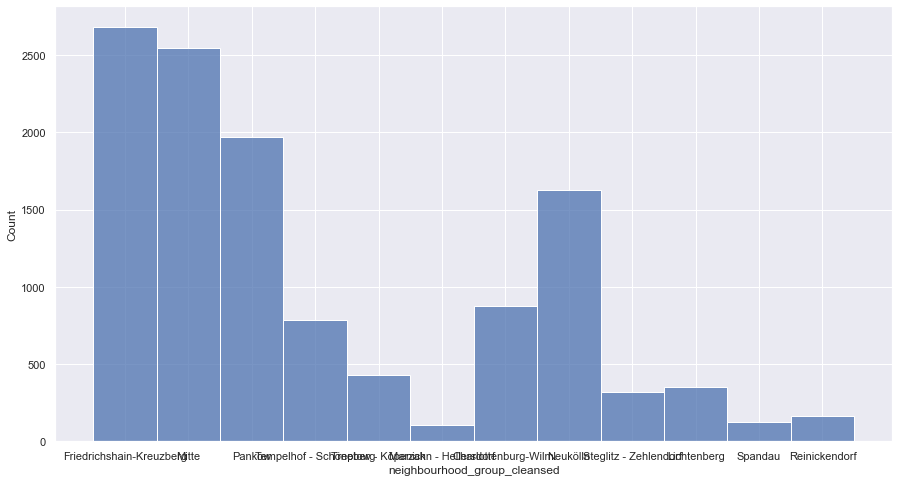

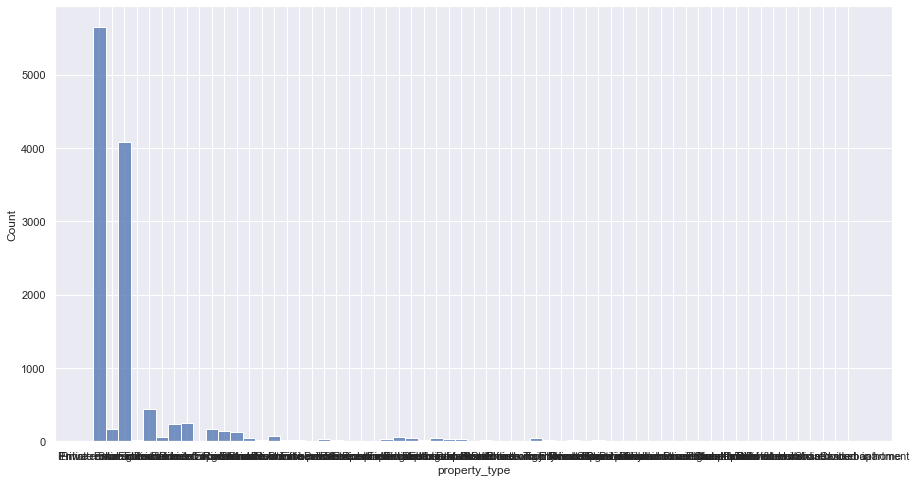

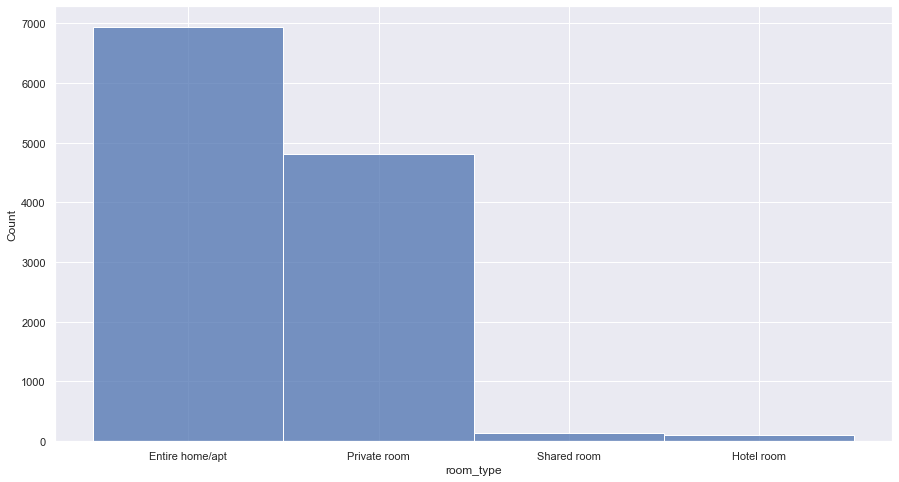

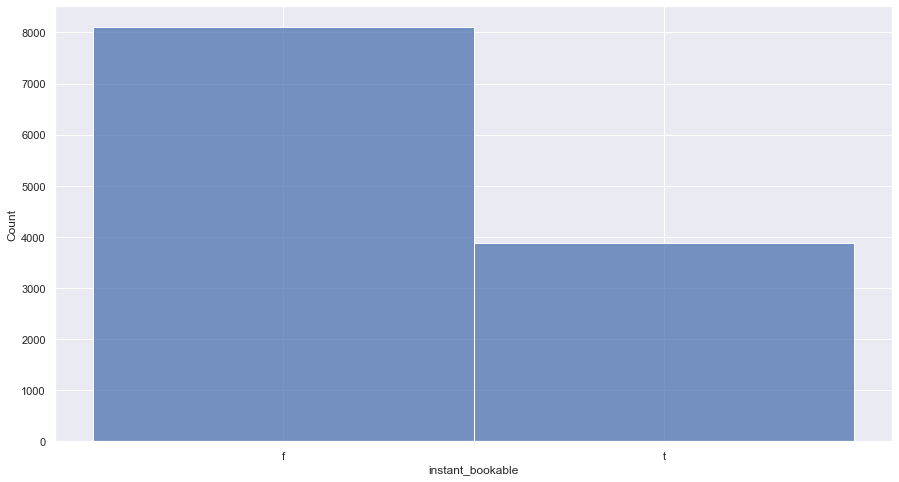

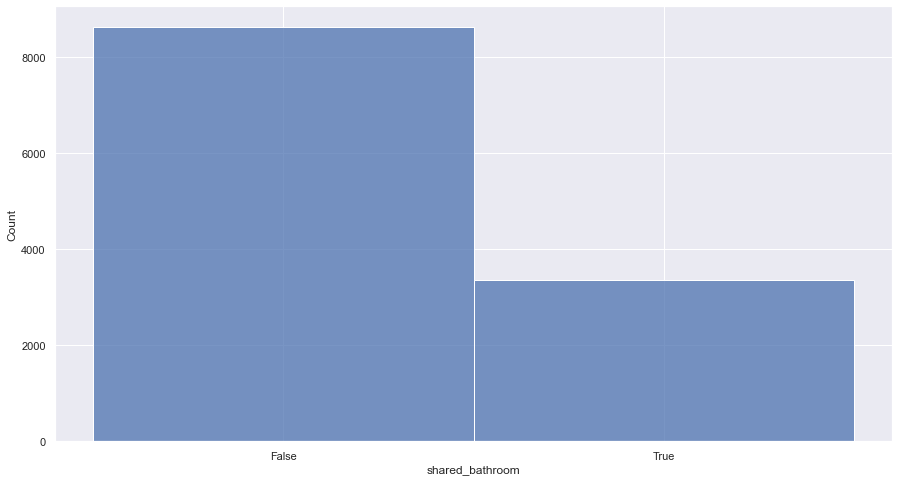

In [276]:
for col in cat.columns:
    sns.histplot(x = col, data = cat)
    plt.show()

In [277]:
### It seems that "neighbourhood_cleansed" and "property_type" have too many values and 
### these columns are relatively redundant with the columns "neighbourhood_group_cleansed"
### and "room_type". Even though they offer more information, I will drop them in order 
### to simplify the model

cat = cat.drop(["neighbourhood_cleansed", "property_type"], axis = 1)
cat

,host_is_superhost,neighbourhood_group_cleansed,room_type,instant_bookable,shared_bathroom
0,f,Friedrichshain-Kreuzberg,Entire home/apt,f,False
2,f,Mitte,Private room,f,True
4,t,Mitte,Entire home/apt,f,False
5,f,Friedrichshain-Kreuzberg,Private room,f,True
6,f,Friedrichshain-Kreuzberg,Private room,f,False
...,...,...,...,...,...
16405,f,Mitte,Entire home/apt,t,False
16406,f,Pankow,Entire home/apt,t,False
16409,f,Marzahn - Hellersdorf,Private room,t,False
16410,f,Lichtenberg,Private room,f,True


In [278]:
cat_true_false = cat[["host_is_superhost", "instant_bookable", "shared_bathroom"]]
cat_true_false

,host_is_superhost,instant_bookable,shared_bathroom
0,f,f,False
2,f,f,True
4,t,f,False
5,f,f,True
6,f,f,False
...,...,...,...
16405,f,t,False
16406,f,t,False
16409,f,t,False
16410,f,f,True


In [279]:
def clean_cattf(x):
    if x == "t":
        return 1
    elif x == "f":
        return 0
    elif x == "True":
        return 1
    elif x == "False":
        return 0

In [280]:
for col in cat_true_false.columns:
    cat_true_false[col] = list(map(clean_cattf, cat_true_false[col]))

cat_true_false

/var/folders/fw/gn4y0r6102q38_7vzn4l62mw0000gp/T/ipykernel_88274/2098168707.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cat_true_false[col] = list(map(clean_cattf, cat_true_false[col]))


,host_is_superhost,instant_bookable,shared_bathroom
0,0,0,0
2,0,0,1
4,1,0,0
5,0,0,1
6,0,0,0
...,...,...,...
16405,0,1,0
16406,0,1,0
16409,0,1,0
16410,0,0,1


In [281]:
cat = cat[["neighbourhood_group_cleansed", "room_type"]]
cat = cat.rename(columns={'neighbourhood_group_cleansed': 'neighbourhood'})
cat = pd.get_dummies(cat, cat.columns)
display(cat)

,neighbourhood_Charlottenburg-Wilm.,neighbourhood_Friedrichshain-Kreuzberg,neighbourhood_Lichtenberg,neighbourhood_Marzahn - Hellersdorf,neighbourhood_Mitte,neighbourhood_Neukölln,neighbourhood_Pankow,neighbourhood_Reinickendorf,neighbourhood_Spandau,neighbourhood_Steglitz - Zehlendorf,neighbourhood_Tempelhof - Schöneberg,neighbourhood_Treptow - Köpenick,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room
0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
4,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
5,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16405,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
16406,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0
16409,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
16410,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0


In [282]:
cat = pd.concat([cat, cat_true_false, ammenities], axis = 1)
cat

,neighbourhood_Charlottenburg-Wilm.,neighbourhood_Friedrichshain-Kreuzberg,neighbourhood_Lichtenberg,neighbourhood_Marzahn - Hellersdorf,neighbourhood_Mitte,neighbourhood_Neukölln,neighbourhood_Pankow,neighbourhood_Reinickendorf,neighbourhood_Spandau,neighbourhood_Steglitz - Zehlendorf,neighbourhood_Tempelhof - Schöneberg,neighbourhood_Treptow - Köpenick,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,host_is_superhost,instant_bookable,shared_bathroom,wifi,kitchen,parking,balcony,bbq,washer
0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,0,0,1
2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,1,1,1,0,1
5,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0
6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16405,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,1,0,0,0,1
16406,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,1,1,0,0,1
16409,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,1,0,0,0,1
16410,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,1,0,0,0


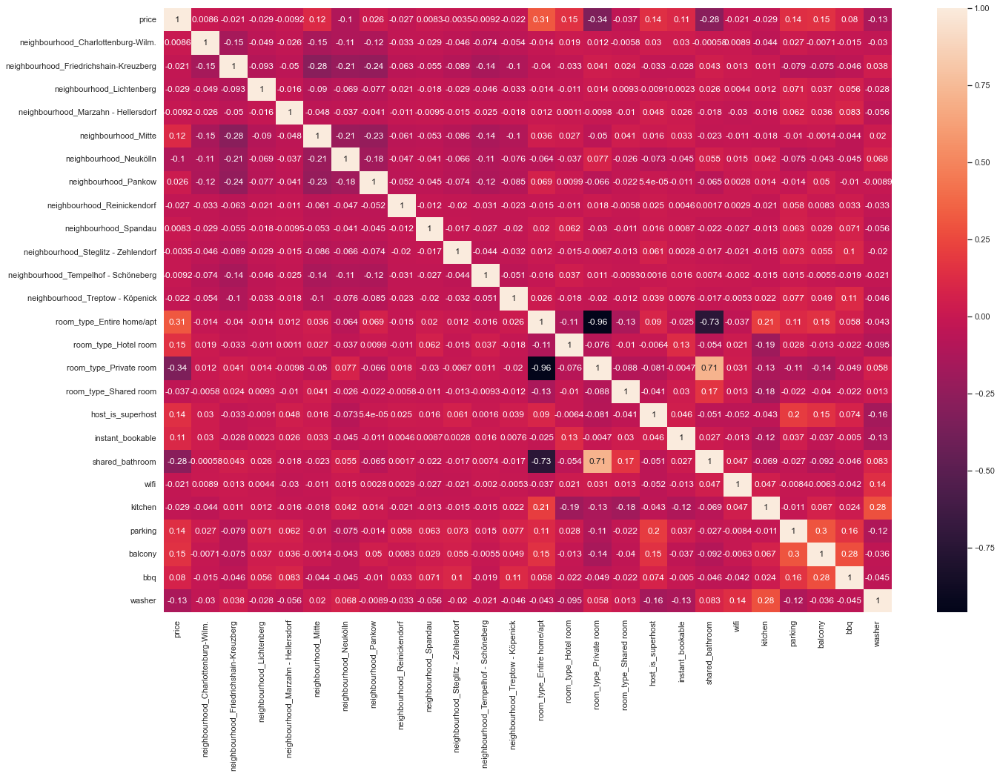

In [283]:
data = pd.concat([listings.loc[:, "price"], cat], axis = 1)
corr_matrix = data.corr()
sns.set(rc={'figure.figsize':(22,15)})
sns.heatmap(corr_matrix, annot=True)
plt.show()

In [284]:
num = listings.select_dtypes("number")
num.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11978 entries, 0 to 16411
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              11978 non-null  int64  
 1   accommodates                    11978 non-null  int64  
 2   n_bathrooms                     11978 non-null  float64
 3   bedrooms                        11978 non-null  float64
 4   beds                            11978 non-null  float64
 5   price                           11978 non-null  float64
 6   number_of_reviews               11978 non-null  int64  
 7   review_scores_rating            11978 non-null  float64
 8   review_scores_accuracy          11978 non-null  float64
 9   review_scores_cleanliness       11978 non-null  float64
 10  review_scores_checkin           11978 non-null  float64
 11  review_scores_communication     11978 non-null  float64
 12  review_scores_location          

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


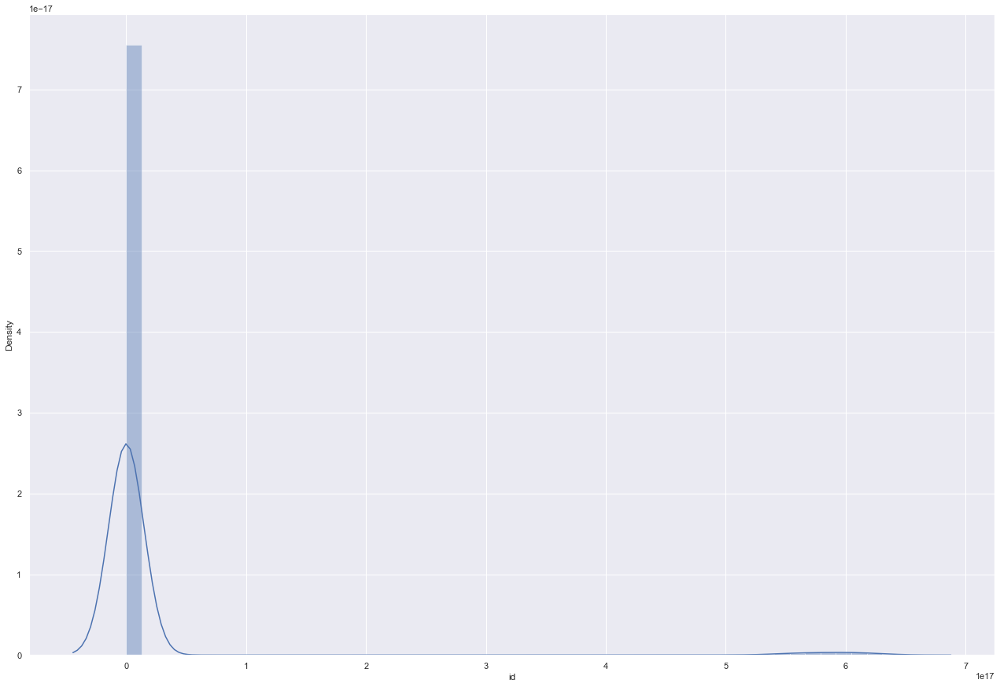

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


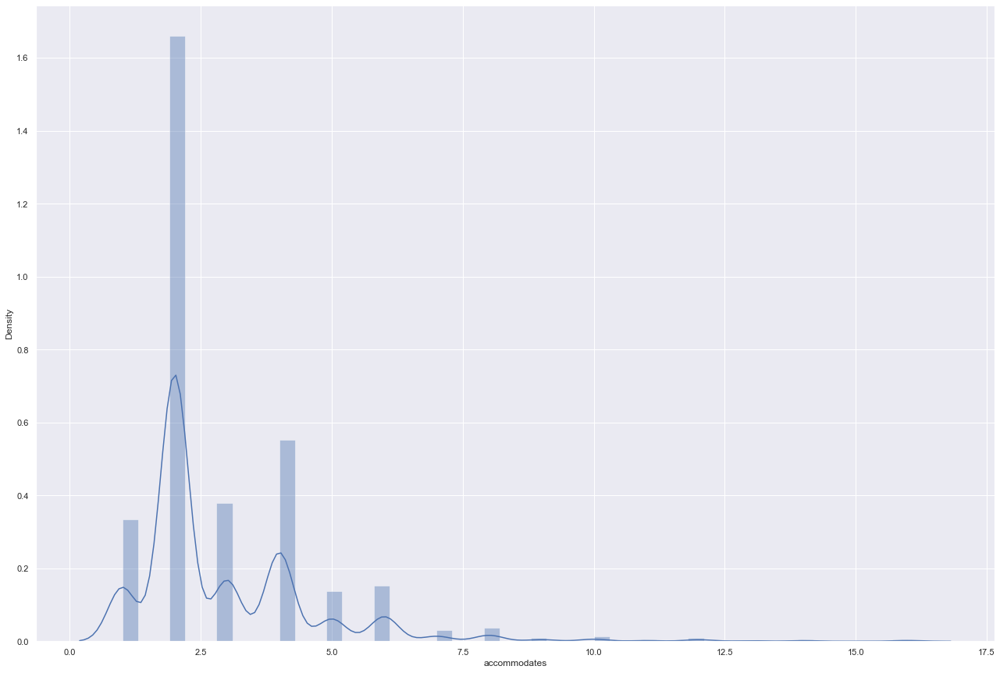

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


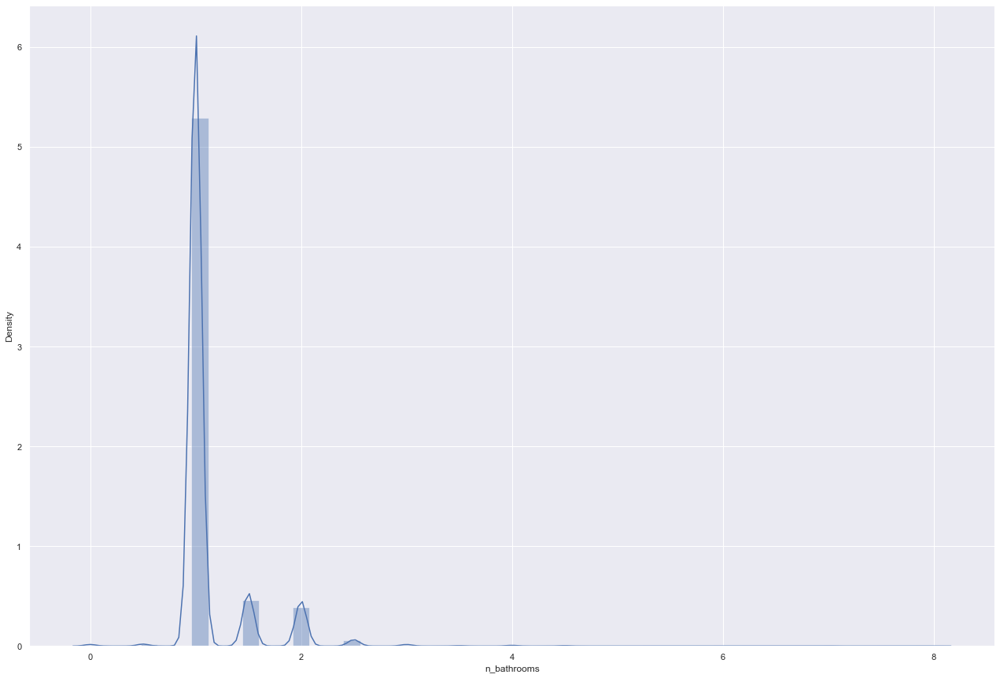

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


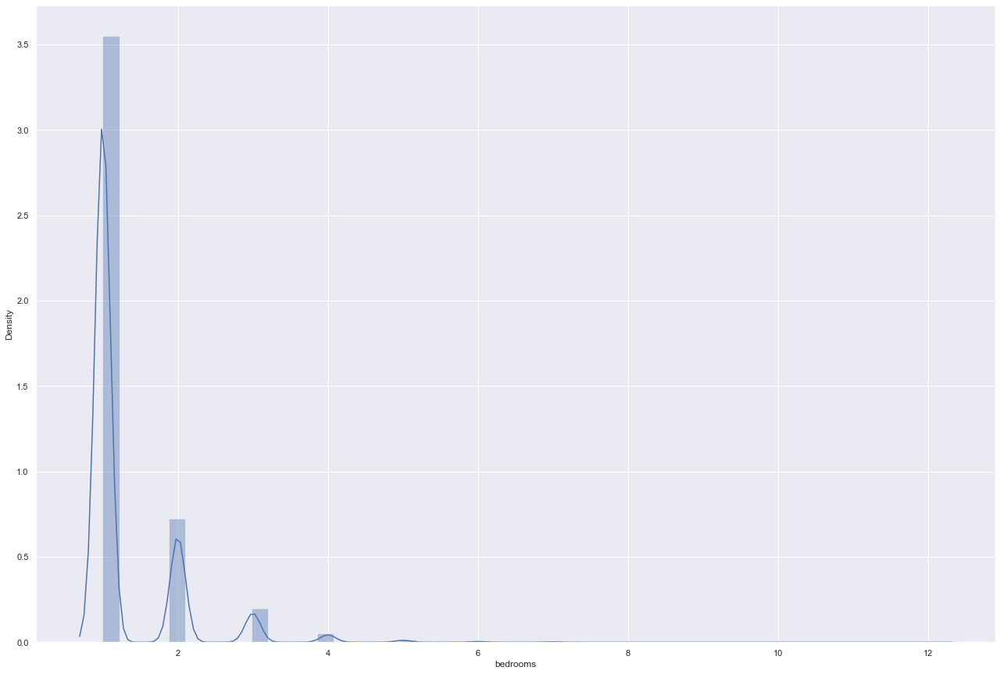

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


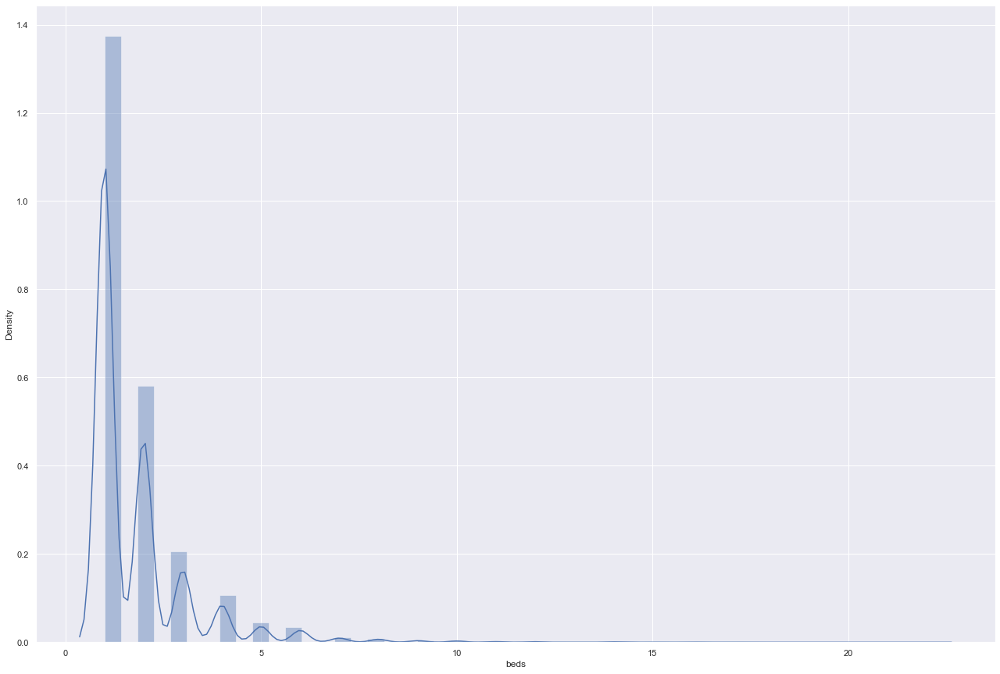

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


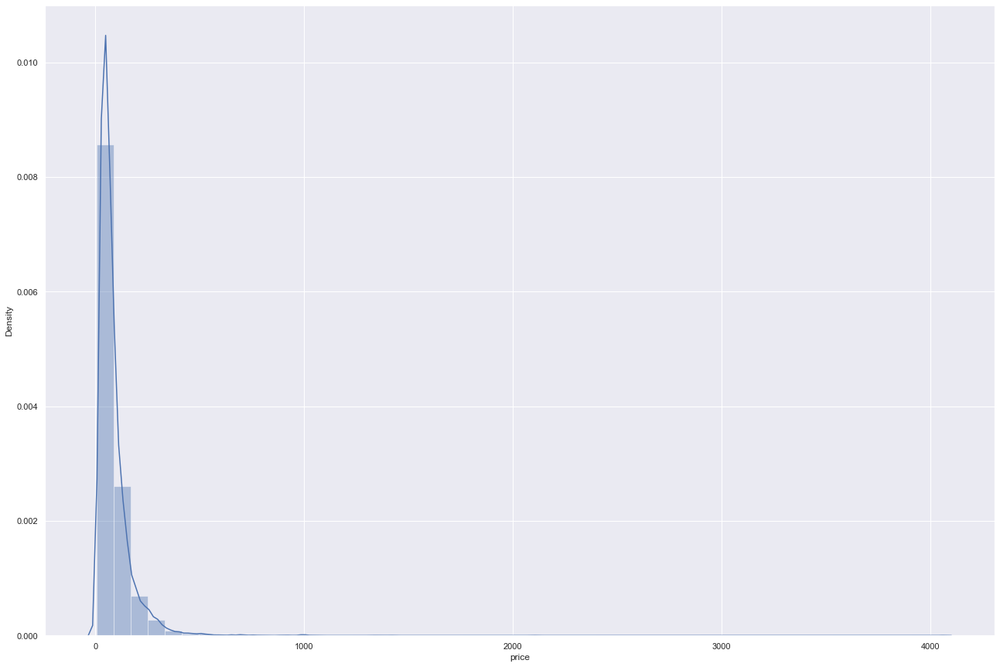

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


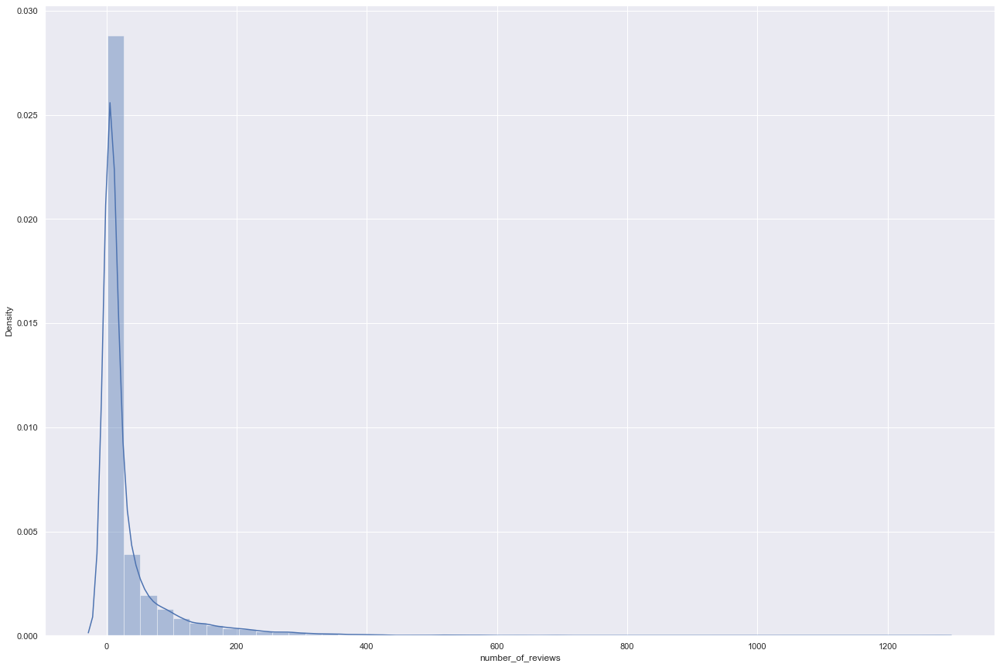

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


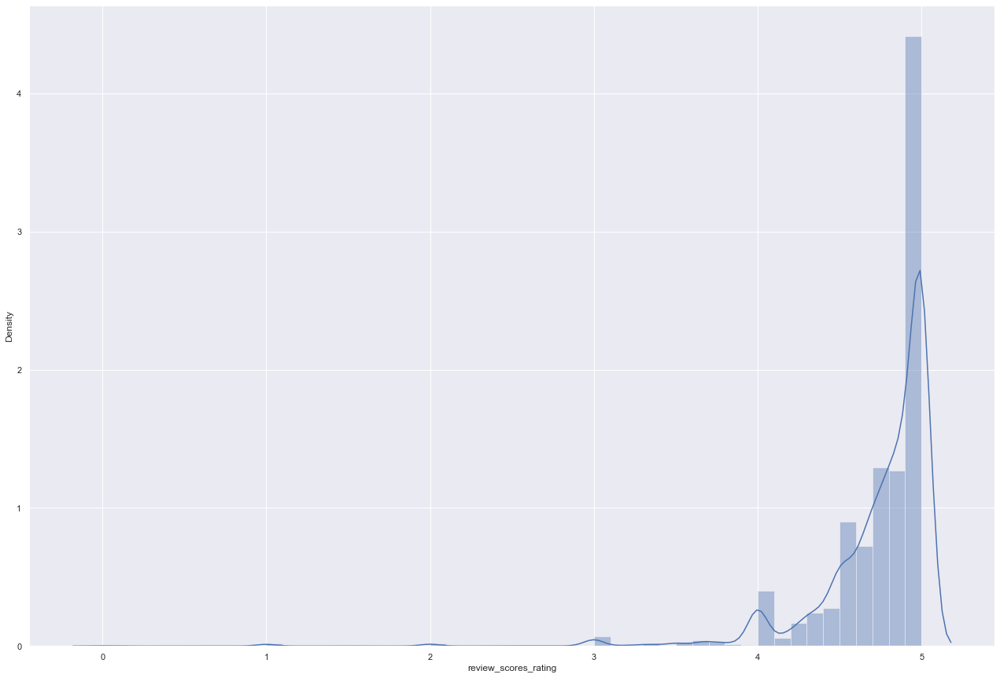

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


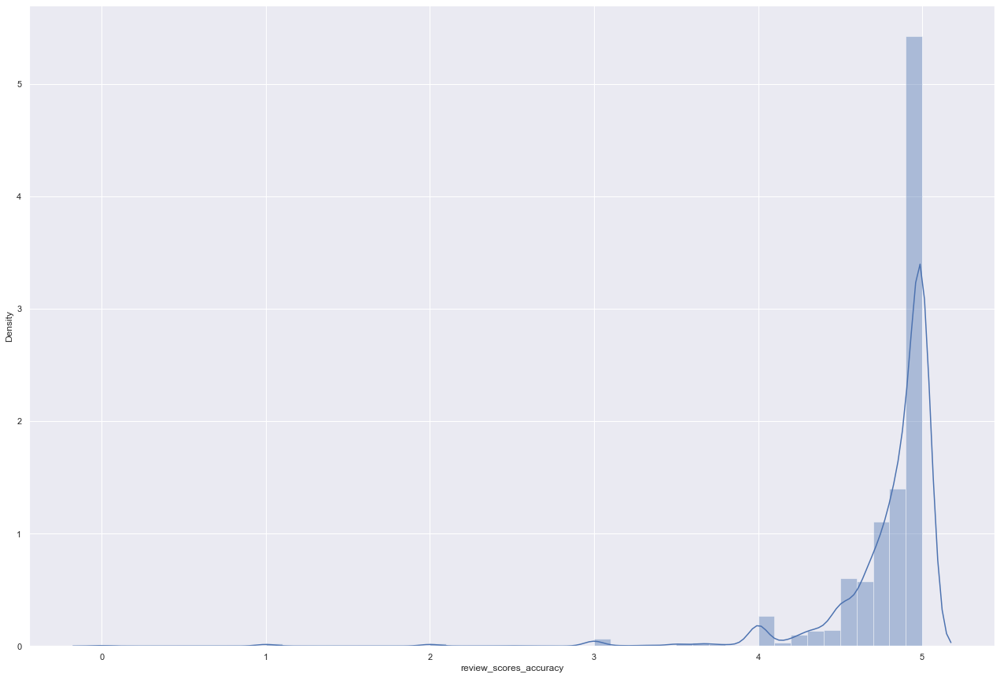

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


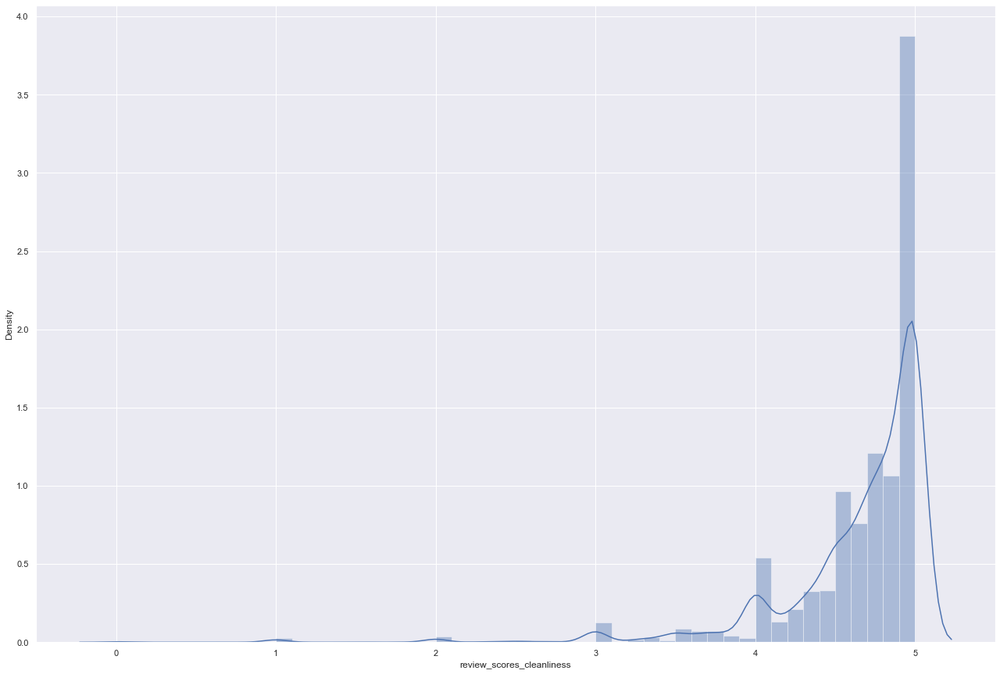

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


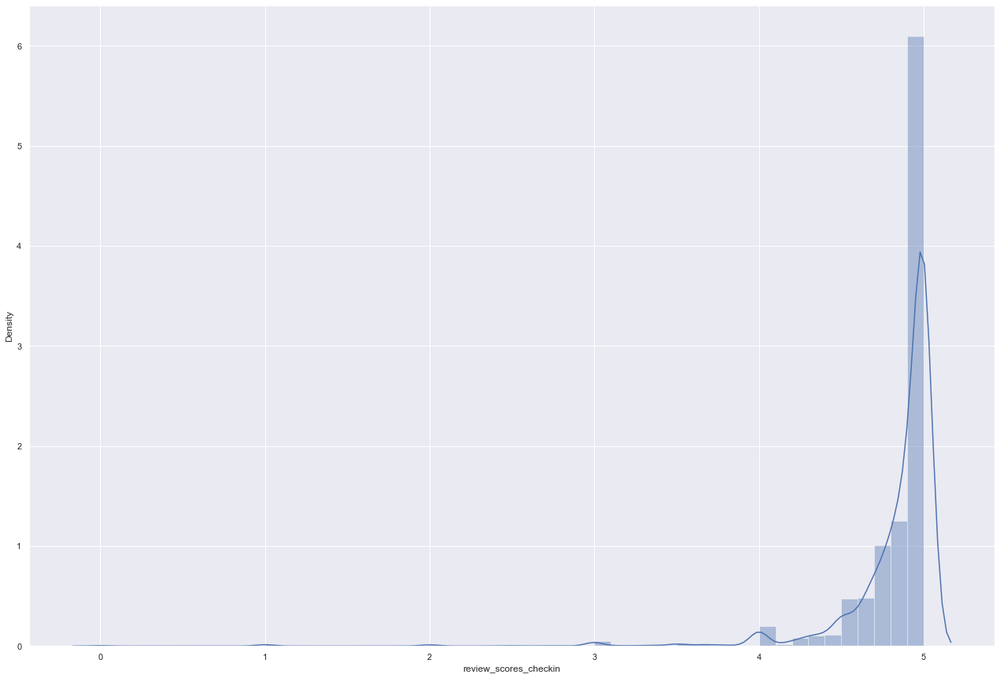

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


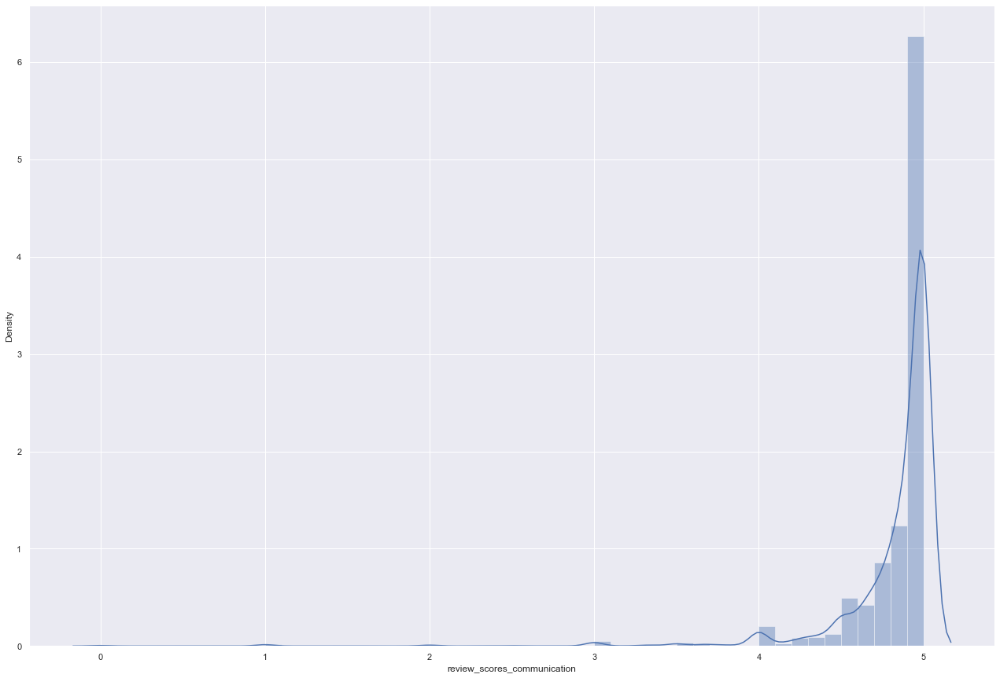

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


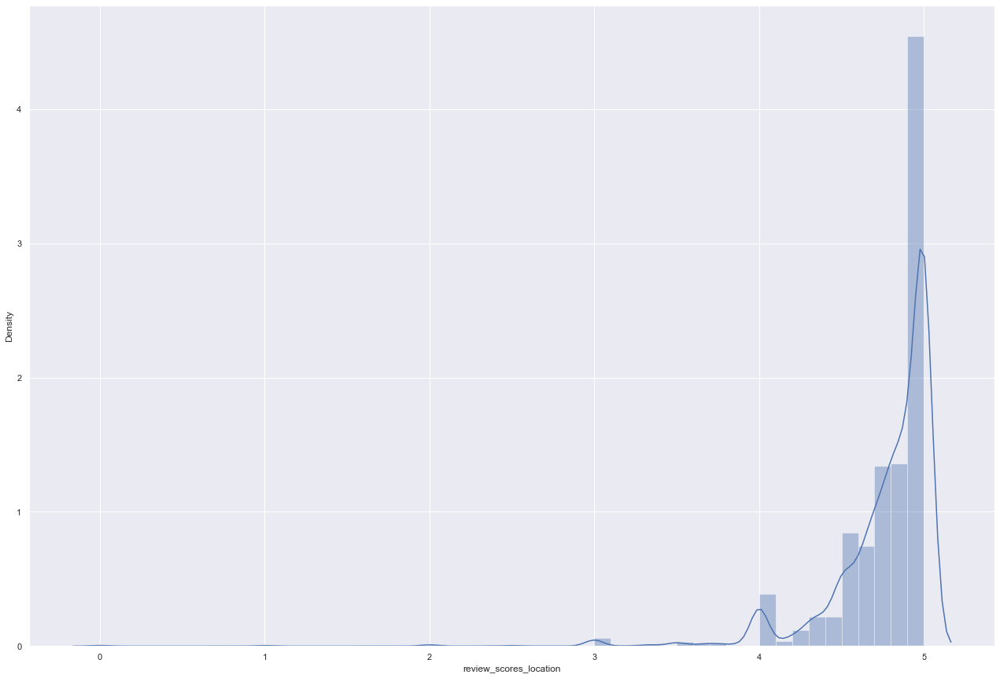

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


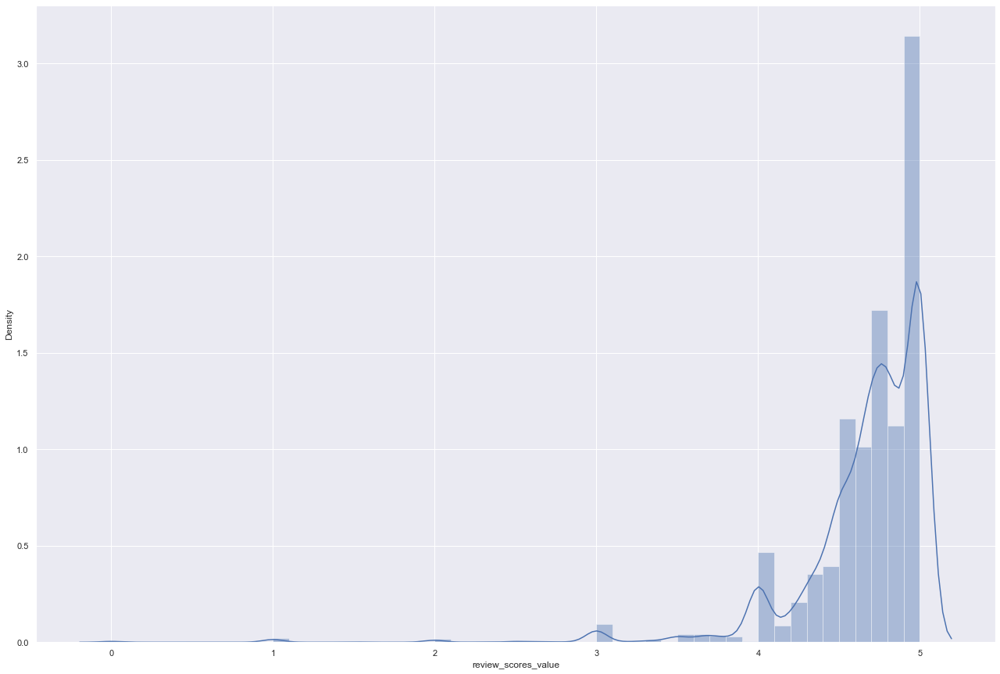

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


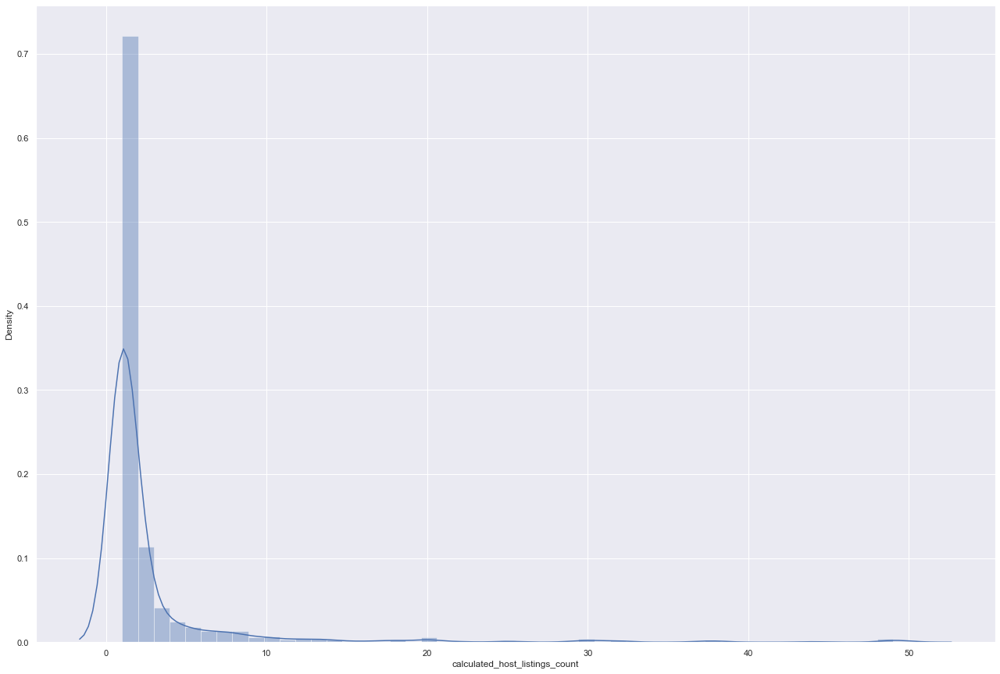

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


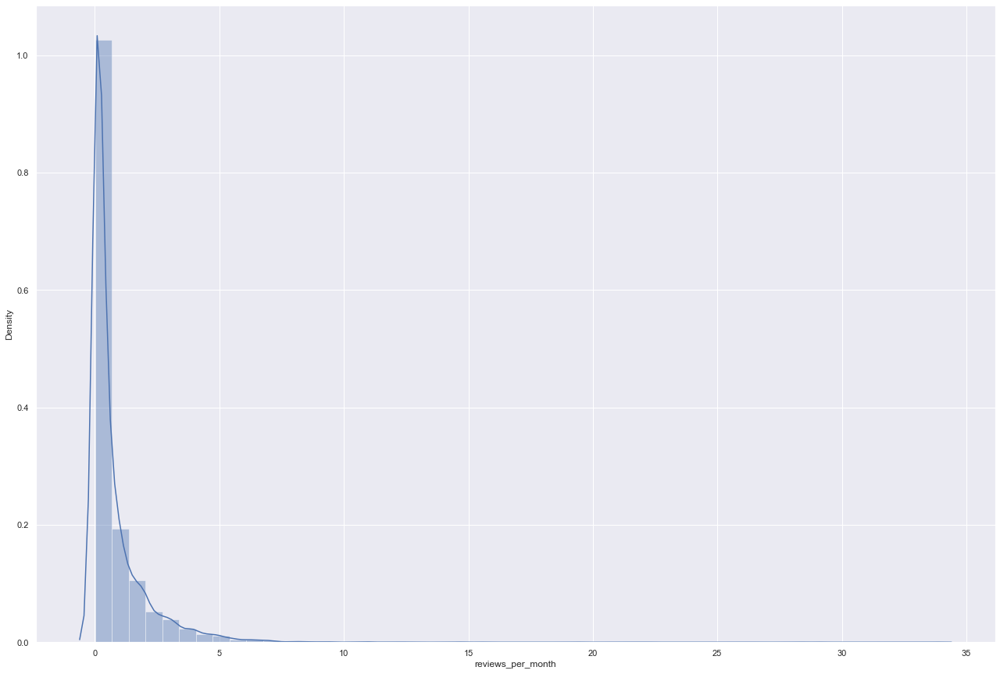

In [285]:
for col in num.columns:
    sns.distplot(num[col])
    plt.show()
    
### The price column is heavily skewed!

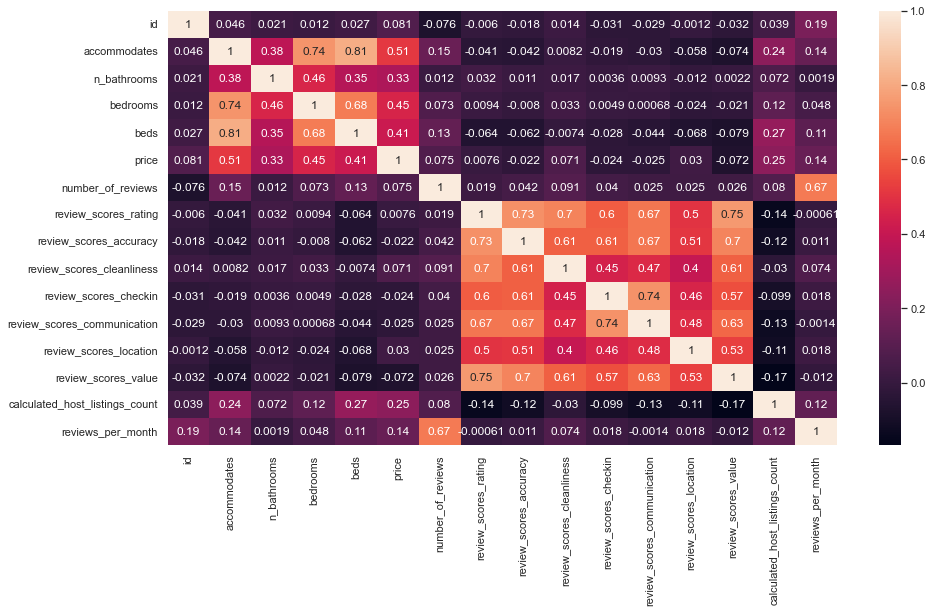

In [286]:
corr_matrix = num.corr()
sns.set(rc={'figure.figsize':(15,8)})
sns.heatmap(corr_matrix, annot=True)
plt.show()

In [287]:
num = num.drop(["beds", "review_scores_value", "review_scores_accuracy", "review_scores_checkin"], axis = 1)
num

,id,accommodates,n_bathrooms,bedrooms,price,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,calculated_host_listings_count,reviews_per_month
0,39971294,2,1.0,1.0,50.0,2,5.00,5.00,5.00,5.00,1,0.06
2,17580693,1,1.0,1.0,42.0,31,4.65,4.58,4.84,4.71,1,0.50
4,17497917,2,1.0,1.0,106.0,116,4.90,4.95,4.87,4.96,1,1.84
5,9924899,1,1.0,1.0,39.0,7,5.00,4.86,5.00,5.00,2,0.09
6,37167219,4,1.0,2.0,80.0,4,4.50,3.50,5.00,4.50,1,0.36
...,...,...,...,...,...,...,...,...,...,...,...,...
16405,45853833,2,1.0,1.0,200.0,2,5.00,5.00,5.00,5.00,1,0.77
16406,36310423,4,1.0,2.0,110.0,88,4.75,4.49,4.99,4.75,1,2.49
16409,52281412,1,2.0,1.0,20.0,1,5.00,3.00,5.00,4.00,2,0.12
16410,2648992,2,1.0,1.0,89.0,9,4.33,4.67,4.89,4.22,3,0.12


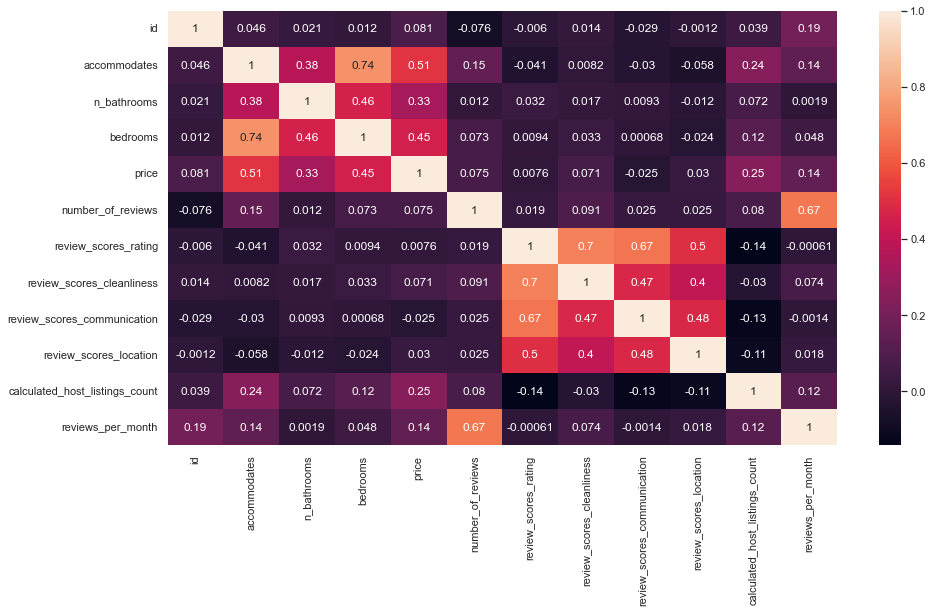

In [288]:
corr_matrix = num.corr()
sns.set(rc={'figure.figsize':(15,8)})
sns.heatmap(corr_matrix, annot=True)
plt.show()

In [289]:
listings = pd.concat([num, cat], axis = 1)
display(listings.head())
print(listings.shape)

,id,accommodates,n_bathrooms,bedrooms,price,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,calculated_host_listings_count,reviews_per_month,neighbourhood_Charlottenburg-Wilm.,neighbourhood_Friedrichshain-Kreuzberg,neighbourhood_Lichtenberg,neighbourhood_Marzahn - Hellersdorf,neighbourhood_Mitte,neighbourhood_Neukölln,neighbourhood_Pankow,neighbourhood_Reinickendorf,neighbourhood_Spandau,neighbourhood_Steglitz - Zehlendorf,neighbourhood_Tempelhof - Schöneberg,neighbourhood_Treptow - Köpenick,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,host_is_superhost,instant_bookable,shared_bathroom,wifi,kitchen,parking,balcony,bbq,washer
0,39971294,2,1.0,1.0,50.0,2,5.00,5.00,5.00,5.00,1,0.06,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,1,0,0,1
2,17580693,1,1.0,1.0,42.0,31,4.65,4.58,4.84,4.71,1,0.50,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0
4,17497917,2,1.0,1.0,106.0,116,4.90,4.95,4.87,4.96,1,1.84,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,1,1,1,0,1
5,9924899,1,1.0,1.0,39.0,7,5.00,4.86,5.00,5.00,2,0.09,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0
6,37167219,4,1.0,2.0,80.0,4,4.50,3.50,5.00,4.50,1,0.36,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,0,1


(11978, 37)


In [290]:
listings = listings.drop_duplicates()
listings = listings.drop(["id"], axis = 1)
listings.shape

(11978, 36)

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='price'>

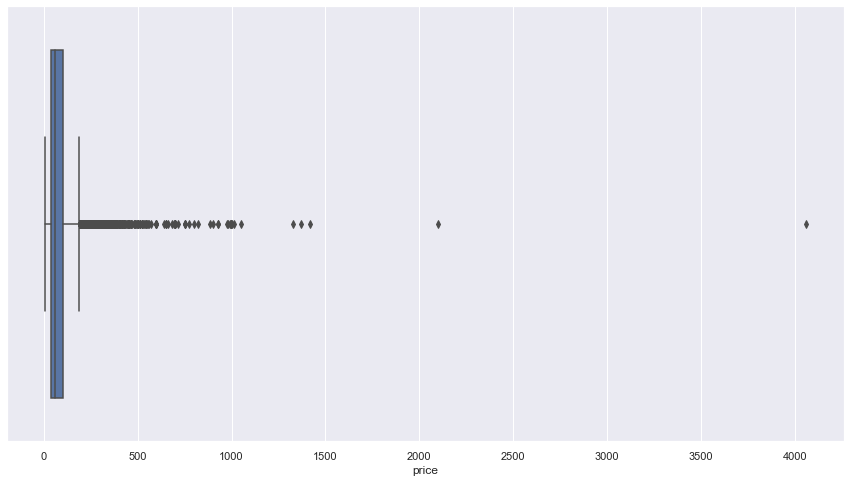

In [291]:
sns.boxplot(listings["price"])

### I will remove extreme outliers for the price column, which the model then wont be able to 
### predict 

In [292]:
listings = listings[listings["price"] <= 1000]
listings.shape

(11971, 36)

In [293]:
### X,y split

y = listings["price"]
x = listings.drop(["price"], axis = 1)

In [294]:
### Train-test split

x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 85)
print(x_train.shape)
print(x_test.shape)

(9576, 35)
(2395, 35)


In [295]:
### Normalization

transformer = MinMaxScaler().fit(x_train)
x_train_norm = transformer.transform(x_train)
x_test_norm = transformer.transform(x_test)
x_train_norm = pd.DataFrame(x_train_norm, columns=x_train.columns, index=x_train.index)
x_test_norm = pd.DataFrame(x_test_norm, columns=x_test.columns, index=x_test.index)
x_train_norm.head()

,accommodates,n_bathrooms,bedrooms,number_of_reviews,review_scores_rating,review_scores_cleanliness,review_scores_communication,review_scores_location,calculated_host_listings_count,reviews_per_month,neighbourhood_Charlottenburg-Wilm.,neighbourhood_Friedrichshain-Kreuzberg,neighbourhood_Lichtenberg,neighbourhood_Marzahn - Hellersdorf,neighbourhood_Mitte,neighbourhood_Neukölln,neighbourhood_Pankow,neighbourhood_Reinickendorf,neighbourhood_Spandau,neighbourhood_Steglitz - Zehlendorf,neighbourhood_Tempelhof - Schöneberg,neighbourhood_Treptow - Köpenick,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,host_is_superhost,instant_bookable,shared_bathroom,wifi,kitchen,parking,balcony,bbq,washer
3334,0.200000,0.125,0.000,0.011830,0.876,0.876,0.950,0.838,0.183673,0.044714,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
718,0.200000,0.125,0.125,0.000000,1.000,1.000,1.000,0.800,0.000000,0.000296,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0
7113,0.066667,0.125,0.000,0.006309,0.900,0.778,0.978,0.978,0.000000,0.008291,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
7597,0.000000,0.125,0.000,0.002366,1.000,1.000,1.000,1.000,0.000000,0.005034,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0
13522,0.000000,0.125,0.000,0.003943,0.900,0.866,0.934,0.866,0.000000,0.001777,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0


/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


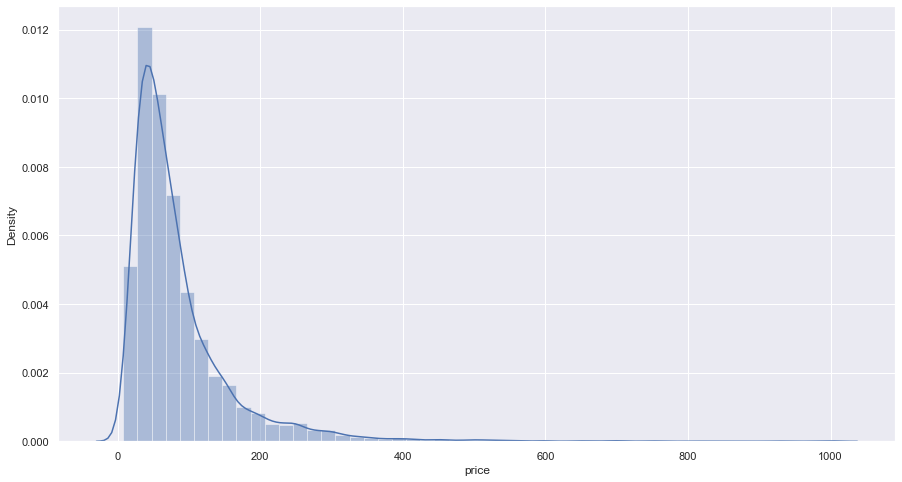

<module 'seaborn' from '/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/__init__.py'>

In [296]:
### The data from the price column is heavily skewed. I will therefore apply a log 
### transformation on the y_test and y_train data

sns.distplot(y_train)
plt.show()
sns

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<function matplotlib.pyplot.show(close=None, block=None)>

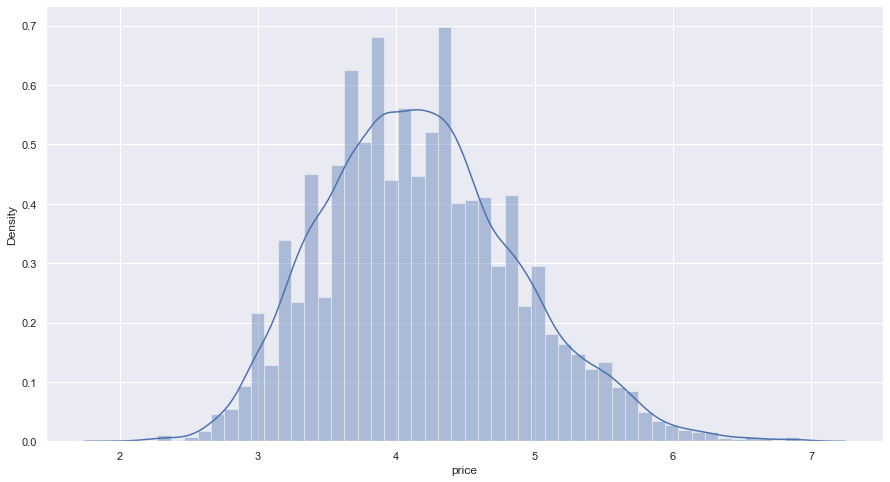

In [297]:
### Log transformation

y_train_log = np.log(y_train)
y_test_log = np.log(y_test)

sns.distplot(y_train_log)
plt.show

In [298]:
### Linear regression model with log y_test and y_train

lm = LinearRegression()
lm.fit(x_train, y_train_log)
y_pred_test = lm.predict(x_test)
y_pred_train = lm.predict(x_train)
r2_train = r2_score(np.exp(y_train_log), np.exp(y_pred_train))
mse_train = mean_squared_error(np.exp(y_train_log), np.exp(y_pred_train))
mae_train = mean_absolute_error(np.exp(y_train_log), np.exp(y_pred_train))
mape_train = mean_absolute_percentage_error(np.exp(y_train_log), np.exp(y_pred_train))
print("r2 train:", r2_train)
print("mse train:", mse_train)
print("mae train:", mae_train)
print("mape train:", mape_train)
r2_test = r2_score(np.exp(y_test_log), np.exp(y_pred_test))
mse_test = mean_squared_error(np.exp(y_test_log), np.exp(y_pred_test))
mae_test = mean_absolute_error(np.exp(y_test_log), np.exp(y_pred_test))
mape_test = mean_absolute_percentage_error(np.exp(y_test_log), np.exp(y_pred_test))
print("r2 test:", r2_test)
print("mse test:", mse_test)
print("mae test:", mae_test)
print("mape test:", mape_test)

r2 train: 0.41599357573060725
mse train: 3590.013706193754
mae train: 30.245031618313256
mape train: 0.36186401659592216
r2 test: 0.34141698875106596
mse test: 3721.677853047239
mae test: 29.234314084372375
mape test: 0.3469628950760266


In [299]:
column_relevance = list(zip(np.abs(lm.coef_), x_train_norm.columns, lm.coef_))
column_relevance.sort(reverse=True)
column_relevance = [(item[1],item[-1],item[0]) for item in column_relevance]
column_relevance

[('room_type_Hotel room', 0.9487171937089355, 0.9487171937089355),
 ('room_type_Shared room', -0.7160388561441636, 0.7160388561441636),
 ('room_type_Private room', -0.33431549653651155, 0.33431549653651155),
 ('neighbourhood_Marzahn - Hellersdorf',
  -0.19214758290262351,
  0.19214758290262351),
 ('neighbourhood_Mitte', 0.17449105732523737, 0.17449105732523737),
 ('kitchen', -0.16335189241991926, 0.16335189241991926),
 ('neighbourhood_Spandau', -0.15870863606323513, 0.15870863606323513),
 ('balcony', 0.15088835371708437, 0.15088835371708437),
 ('neighbourhood_Friedrichshain-Kreuzberg',
  0.14874655525213856,
  0.14874655525213856),
 ('review_scores_location', 0.1481079435023972, 0.1481079435023972),
 ('neighbourhood_Charlottenburg-Wilm.',
  0.13361500650376706,
  0.13361500650376706),
 ('neighbourhood_Reinickendorf', -0.1303247106026461, 0.1303247106026461),
 ('neighbourhood_Pankow', 0.1301284561031784, 0.1301284561031784),
 ('n_bathrooms', 0.12332664590087378, 0.12332664590087378),
 (

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'y_test')

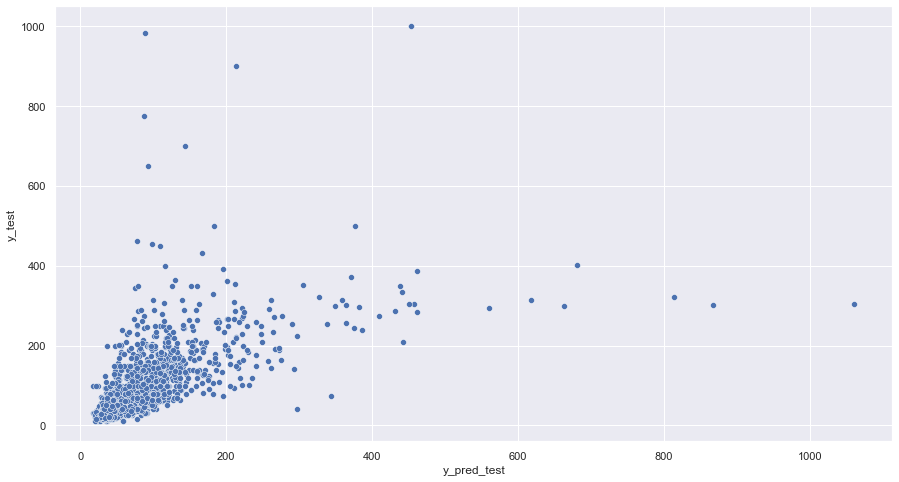

In [300]:
sns.scatterplot(np.exp(y_pred_test), y_test)
plt.xlabel('y_pred_test')
plt.ylabel('y_test')

Text(0.5, 0, 'y_test - y_pred_test')

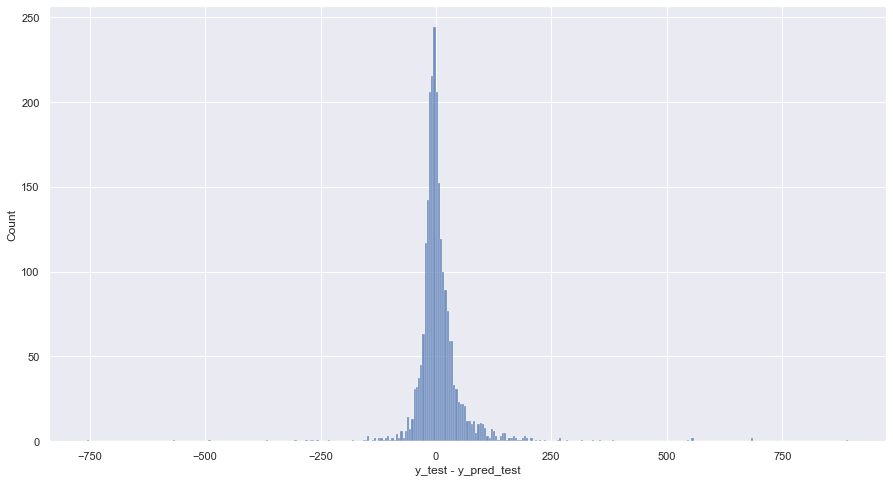

In [301]:
error = y_test - np.exp(y_pred_test)
sns.histplot(error)
plt.xlabel('y_test - y_pred_test')

In [302]:
lm = LinearRegression()
lm.fit(x_train, y_train)
y_pred_test = lm.predict(x_test)
y_pred_train = lm.predict(x_train)
r2_train = r2_score(y_train, y_pred_train)
mse_train = mean_squared_error(y_train, y_pred_train)
mae_train = mean_absolute_error(y_train, y_pred_train)
mape_train = mean_absolute_percentage_error(y_train, y_pred_train)
print("r2 train:", r2_train)
print("mse train:", mse_train)
print("mae train:", mae_train)
print("mape train:", mape_train)
r2_test = r2_score(y_test, y_pred_test)
mse_test = mean_squared_error(y_test, y_pred_test)
mae_test = mean_absolute_error(y_test, y_pred_test)
mape_test = mean_absolute_percentage_error(y_test, y_pred_test)
print("r2 test:", r2_test)
print("mse test:", mse_test)
print("mae test:", mae_test)
print("mape test:", mape_test)

r2 train: 0.4892626719057831
mse train: 3139.61273699487
mae train: 32.087627933709555
mape train: 0.4617805743768457
r2 test: 0.47693854201996644
mse test: 2955.840358309943
mae test: 30.67560885471015
mape test: 0.4549208641521138


In [303]:
column_relevance = list(zip(np.abs(lm.coef_), x_train_norm.columns, lm.coef_))
column_relevance.sort(reverse=True)
column_relevance = [(item[1],item[-1],item[0]) for item in column_relevance]
column_relevance

[('room_type_Hotel room', 122.38236669681888, 122.38236669681888),
 ('room_type_Shared room', -72.2193200931078, 72.2193200931078),
 ('room_type_Private room', -35.01968726259633, 35.01968726259633),
 ('n_bathrooms', 30.911880882567786, 30.911880882567786),
 ('neighbourhood_Marzahn - Hellersdorf',
  -21.535815271240583,
  21.535815271240583),
 ('neighbourhood_Mitte', 21.484570061639477, 21.484570061639477),
 ('neighbourhood_Spandau', -17.405447784795506, 17.405447784795506),
 ('bedrooms', 15.176243344600431, 15.176243344600431),
 ('room_type_Entire home/apt', -15.143359341085946, 15.143359341085946),
 ('neighbourhood_Friedrichshain-Kreuzberg',
  14.52723981699862,
  14.52723981699862),
 ('host_is_superhost', 14.175468994677138, 14.175468994677138),
 ('accommodates', 13.551485280081636, 13.551485280081636),
 ('balcony', 12.154880863616192, 12.154880863616192),
 ('neighbourhood_Pankow', 12.097599197071244, 12.097599197071244),
 ('neighbourhood_Charlottenburg-Wilm.', 11.34366040751223, 11

/Users/origenolet/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'y_test')

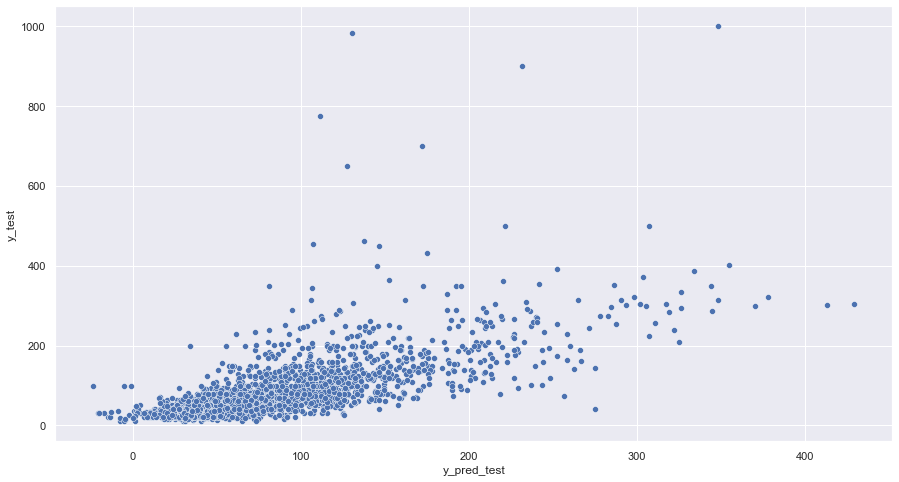

In [304]:
sns.scatterplot(y_pred_test, y_test)
plt.xlabel('y_pred_test')
plt.ylabel('y_test')

Text(0.5, 0, 'y_test - y_pred_test')

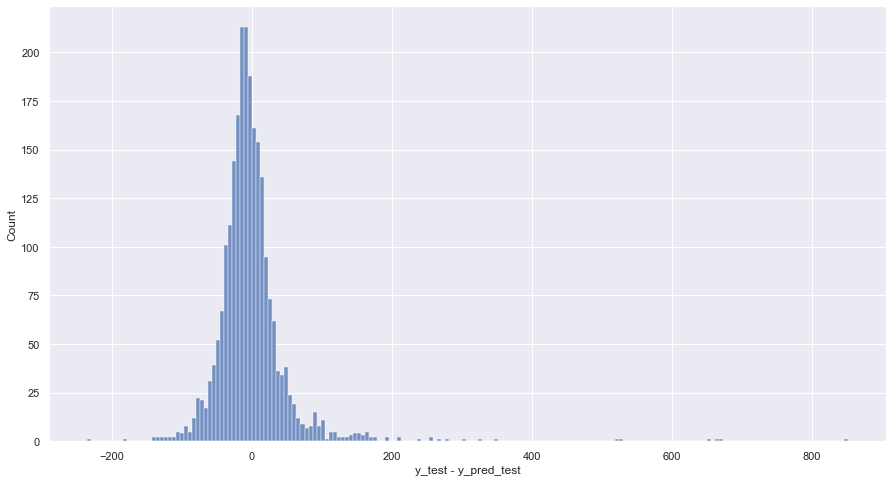

In [305]:
error = y_test - y_pred_test
sns.histplot(error)
plt.xlabel('y_test - y_pred_test')